In [1]:
# Some useful settings for interactive work
%load_ext autoreload
%autoreload 2
%matplotlib widget

In [2]:
import plotters as pt
import os 
import pickle


In [3]:
import numpy as np
import transformers as tf



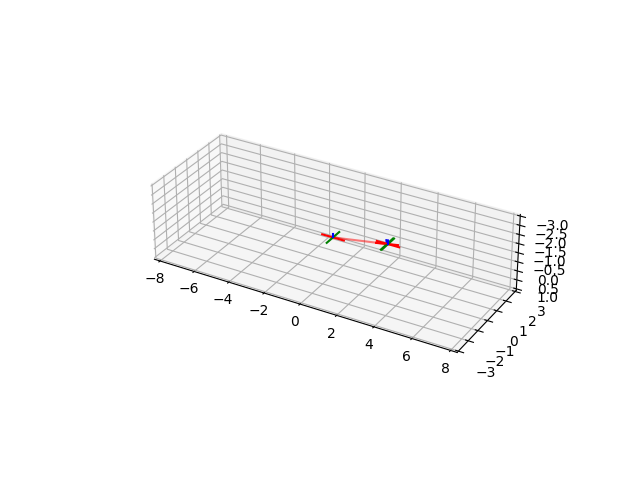

In [4]:
data_path = os.path.join("data","ascend"+".pkl")

# Load Flight Data
with open(data_path,'rb') as file:
    idl_data = pickle.load(file)

Ti:np.ndarray   = idl_data['Ti']
FOi:np.ndarray  = idl_data['FOi'] #ask more data 10,000 more the better duplicate trajectories
tXUi:np.ndarray = idl_data['tXUi']
Ci:np.ndarray   = idl_data['Ci']

pt.tXU_to_3D([tXUi])

In [5]:
print("Ti (first 5 entries):", Ti[:5])
print("FOi (first 5 entries):", FOi[:5])
print("tXUi (first 5 entries):", tXUi[:5])
print("Ci (first 5 entries):", Ci[:5])


Ti (first 5 entries): [0.    0.005 0.01  0.015 0.02 ]
FOi (first 5 entries): [[[-7.85304432e-08 -1.10725772e-07 -3.37095344e-08 -1.50306686e-07
    3.10459506e+01 -1.23494508e+02  2.00253226e+02 -1.03822200e+02
   -1.11992149e+02  2.42301746e+02 -3.19639958e+02  1.96666868e+02]
  [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
    0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
    0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00]
  [-9.99691994e-01  2.87610334e-08  3.06035762e-09  1.52245551e-08
   -5.17432508e+00  2.05824180e+01 -3.33755376e+01  1.73037003e+01
    1.86653572e+01 -4.03836226e+01  5.32733241e+01 -3.27778099e+01]
  [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
    0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
    0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00]]

 [[-7.82792199e-08  5.32683648e-07  3.85472331e-04  1.53690091e-01
    3.04309791e+01 -1.22494542e+02  1.99732720

In [6]:
# Extract x position data from FOi
x_positions_FOi = FOi[:, 0, 0]


In [7]:
import numpy as np
# Parameters for noise injection
noise_level = 0 # Adjust based on your data's scale
desired_size = 100000  # Total desired number of data points

# Initialize the synthetic dataset with the original data
synthetic_data = np.copy(x_positions_FOi)

# Generate synthetic data points until reaching the desired size
while len(synthetic_data) < desired_size:
    # Iterate through the original data in order
    for base_point in x_positions_FOi:
        # Check if adding another point would exceed the desired size
        if len(synthetic_data) >= desired_size:
            break  # Stop if we have reached or exceeded the desired size
        
        # Generate a new point by adding Gaussian noise to the base point
        new_point = base_point + np.random.normal(0, noise_level)
        
        # Append the new point to the synthetic dataset
        synthetic_data = np.append(synthetic_data, new_point)

# Now synthetic_data contains the original points plus the newly generated ones, totaling around 10,000


In [8]:
print(synthetic_data)

[-7.85304432e-08 -7.82792199e-08 -6.68062329e-08 ...  7.83874093e-01
  7.93187798e-01  8.02546108e-01]


In [9]:

# Prepare dataset for supervised learning
X_FOi = synthetic_data[:-1]  # Current x positions
y_FOi = synthetic_data[1:]   # Next x positions

# Manually split the dataset into training, validation, and test sets
indices_FOi = np.arange(X_FOi.shape[0])

# Determine split sizes based on the corrected dataset size
train_size_FOi = int(0.8 * len(indices_FOi))  # 80% for training
val_size_FOi = int(0.1 * len(indices_FOi))    # 10% for validation
test_size_FOi = len(indices_FOi) - train_size_FOi - val_size_FOi  # The remaining 10% for testing

# Split the dataset indices
train_indices_FOi = indices_FOi[:train_size_FOi]
val_indices_FOi = indices_FOi[train_size_FOi:train_size_FOi + val_size_FOi]
test_indices_FOi = indices_FOi[train_size_FOi + val_size_FOi:]

# Extract the dataset splits using the indices
X_train_FOi = X_FOi[train_indices_FOi]
y_train_FOi = y_FOi[train_indices_FOi]

X_val_FOi = X_FOi[val_indices_FOi]
y_val_FOi = y_FOi[val_indices_FOi]

X_test_FOi = X_FOi[test_indices_FOi]
y_test_FOi = y_FOi[test_indices_FOi]

# Output the shapes of the splits to confirm the process
X_train_FOi.shape, X_val_FOi.shape, X_test_FOi.shape,y_train_FOi.shape, y_val_FOi.shape, y_test_FOi.shape

((79999,), (9999,), (10001,), (79999,), (9999,), (10001,))

In [10]:
print("Min value in X_train_FOi:", np.min(x_positions_FOi))
print("Max value in X_train_FOi:", np.max(x_positions_FOi))
print(x_positions_FOi)


Min value in X_train_FOi: -7.853044322293487e-08
Max value in X_train_FOi: 2.9991701989815738
[-7.85304432e-08 -7.82792199e-08 -6.68062329e-08 -1.54859788e-08
  1.22945690e-07  4.14013440e-07  9.41127437e-07  1.80521142e-06
  3.12433386e-06  5.03334223e-06  7.68350026e-06  1.12421284e-05
  1.58922471e-05  2.18322236e-05  2.92754209e-05  3.84498510e-05
  4.95978298e-05  6.29756362e-05  7.88531733e-05  9.75136331e-05
  1.19253164e-04  1.44380542e-04  1.73216843e-04  2.06095120e-04
  2.43360081e-04  2.85367776e-04  3.32485277e-04  3.85090367e-04
  4.43571234e-04  5.08326164e-04  5.79763234e-04  6.58300020e-04
  7.44363289e-04  8.38388716e-04  9.40820582e-04  1.05211149e-03
  1.17272209e-03  1.30312076e-03  1.44378339e-03  1.59519301e-03
  1.75783963e-03  1.93221988e-03  2.11883675e-03  2.31819938e-03
  2.53082274e-03  2.75722740e-03  2.99793925e-03  3.25348926e-03
  3.52441322e-03  3.81125150e-03  4.11454880e-03  4.43485389e-03
  4.77271939e-03  5.12870151e-03  5.50335983e-03  5.89725707e

In [11]:
import numpy as np

def normalize_data(data, feature_range=(0, 1)):
    """
    Normalize data to a specified range.

    Parameters:
    - data: Data to be normalized (numpy array).
    - feature_range: Tuple (min, max) specifying the range of the normalized data.

    Returns:
    - normalized_data: Normalized data.
    """
    min_val, max_val = feature_range
    data_min = np.min(data)
    data_max = np.max(data)
    # Scale data to [0,1]
    normalized_data = (data - data_min) / (data_max - data_min)
    # Scale data to feature_range
    normalized_data = normalized_data * (max_val - min_val) + min_val
    return normalized_data


In [12]:
import numpy as np

# Example input data
data = np.array([2, 1, 3])

# Normalizing the data
normalized_data = normalize_data(data, feature_range=(0, 1))

print("Original data:", data)
print("Normalized data:", normalized_data)


Original data: [2 1 3]
Normalized data: [0.5 0.  1. ]


In [13]:
import numpy as np

Xtr_data_normalized = normalize_data(X_train_FOi, feature_range=(0,1))
print(Xtr_data_normalized)
Ytr_data_normalized = normalize_data(np.array(y_train_FOi))
Xv_data_normalized = normalize_data(np.array(X_val_FOi))
Yv_data_normalized = normalize_data(np.array(y_val_FOi))
Xte_data_normalized = normalize_data(np.array(X_test_FOi))
Yte_data_normalized = normalize_data(np.array(y_test_FOi))

# Scale to an integer range, e.g., [0, 100]
xtrint_data = np.round(Xtr_data_normalized * 100).astype(np.int64)
ytrint_data = np.round(Ytr_data_normalized * 100).astype(np.int64)
xvint_data = np.round(Xv_data_normalized * 100).astype(np.int64)
yvint_data = np.round(Yv_data_normalized * 100).astype(np.int64)
xteint_data = np.round(Xte_data_normalized * 100).astype(np.int64)
yteint_data = np.round(Yte_data_normalized * 100).astype(np.int64)

# Choose SOS and EOS tokens
SOS_token = 12  # Start of sequence token
EOS_token = 13  # End of sequence token


[0.00000000e+00 8.37642588e-11 3.90915128e-09 ... 3.27073548e-03
 3.46838142e-03 3.67435923e-03]


In [14]:
print("Original:", X_train_FOi[:10])
normalized = normalize_data(X_train_FOi)
print("Normalized:", normalized[:10])
scaled_and_rounded = np.round(normalized * 100).astype(np.int64)
print("Scaled and Rounded:", scaled_and_rounded[:10])


Original: [-7.85304432e-08 -7.82792199e-08 -6.68062329e-08 -1.54859788e-08
  1.22945690e-07  4.14013440e-07  9.41127437e-07  1.80521142e-06
  3.12433386e-06  5.03334223e-06]
Normalized: [0.00000000e+00 8.37642588e-11 3.90915128e-09 2.10206352e-08
 6.71772906e-08 1.64226715e-07 3.39979990e-07 6.28087667e-07
 1.06791679e-06 1.70442896e-06]
Scaled and Rounded: [0 0 0 0 0 0 0 0 0 0]


In [15]:
X_train_FOi

array([-7.85304432e-08, -7.82792199e-08, -6.68062329e-08, ...,
        9.80941410e-03,  1.04021879e-02,  1.10199505e-02])

In [16]:
print(xtrint_data)

[0 0 0 ... 0 0 0]


In [17]:
# Assuming xtrint_data is your input data scaled to [0, 100]
import numpy as np

# Generate 11 equally spaced bin edges from 0 to 10, creating 10 bins
bin_edges = np.linspace(0, 100, num=11)

print(bin_edges)

xtrint_data_binned = np.digitize(xtrint_data, bins=bin_edges)
ytrint_data_binned = np.digitize(ytrint_data, bins=bin_edges)
xvint_data_binned = np.digitize(xvint_data, bins=bin_edges)
yvint_data_binned = np.digitize(yvint_data, bins=bin_edges)
xteint_data_binned = np.digitize(xteint_data, bins=bin_edges)
yteint_data_binned = np.digitize(yteint_data, bins=bin_edges)

[  0.  10.  20.  30.  40.  50.  60.  70.  80.  90. 100.]


In [18]:
print(xtrint_data_binned)

[1 1 1 ... 1 1 1]


In [19]:
import numpy as np

def segment_data(X, Y, length=10, SOS_token=12, EOS_token=13):
    """
    Segments the given X and Y arrays into sequences of the specified length,
    including SOS and EOS tokens at the beginning and end of each sequence.
    Each sequence overlaps with the next, where the last element of one sequence
    is the first element of the next.

    Parameters:
    - X: Input data array
    - Y: Target data array
    - length: The length of each segmented sequence (default: 8)
    - SOS_token: Start of sequence token (default: -1) -this token should change it's value it could mess data
    - EOS_token: End of sequence token (default: 10001) -this token should change it's value it could mess data

    Returns:
    - A list of segmented data pairs [segmented_X, segmented_Y] with SOS and EOS tokens
    """
    data = []
    X = np.array(X)
    Y = np.array(Y)

    for i in range(len(X) - length + 1):
        X_segment = X[i:i + length]
        Y_segment = Y[i:i + length]
        
        # Print original segments before adding tokens
        print(f'Original X_segment[{i}]: {X_segment}')
        print(f'Original Y_segment[{i}]: {Y_segment}')
        
        # Insert SOS at the beginning and EOS at the end of each segment
        X_segment = np.insert(X_segment, 0, SOS_token)
        Y_segment = np.insert(Y_segment, 0, SOS_token)
        X_segment = np.append(X_segment, EOS_token)
        Y_segment = np.append(Y_segment, EOS_token)
        
        # Print segments after adding tokens
        print(f'With Tokens X_segment[{i}]: {X_segment}')
        print(f'With Tokens Y_segment[{i}]: {Y_segment}')

        data.append([X_segment, Y_segment])

    np.random.shuffle(data)
    return data

# Example usage with your data:
X_data = xtrint_data_binned  # Your X_train data here
Y_data = ytrint_data_binned # Your Y_train data here

train_segmented_data = segment_data(X_data, Y_data, length=10)
for pair in train_segmented_data[:5]:  # Print the first 5 pairs to check
    print(f'X: {pair[0]}, Y: {pair[1]}')


Original X_segment[0]: [1 1 1 1 1 1 1 1 1 1]
Original Y_segment[0]: [1 1 1 1 1 1 1 1 1 1]
With Tokens X_segment[0]: [12  1  1  1  1  1  1  1  1  1  1 13]
With Tokens Y_segment[0]: [12  1  1  1  1  1  1  1  1  1  1 13]
Original X_segment[1]: [1 1 1 1 1 1 1 1 1 1]
Original Y_segment[1]: [1 1 1 1 1 1 1 1 1 1]
With Tokens X_segment[1]: [12  1  1  1  1  1  1  1  1  1  1 13]
With Tokens Y_segment[1]: [12  1  1  1  1  1  1  1  1  1  1 13]
Original X_segment[2]: [1 1 1 1 1 1 1 1 1 1]
Original Y_segment[2]: [1 1 1 1 1 1 1 1 1 1]
With Tokens X_segment[2]: [12  1  1  1  1  1  1  1  1  1  1 13]
With Tokens Y_segment[2]: [12  1  1  1  1  1  1  1  1  1  1 13]
Original X_segment[3]: [1 1 1 1 1 1 1 1 1 1]
Original Y_segment[3]: [1 1 1 1 1 1 1 1 1 1]
With Tokens X_segment[3]: [12  1  1  1  1  1  1  1  1  1  1 13]
With Tokens Y_segment[3]: [12  1  1  1  1  1  1  1  1  1  1 13]
Original X_segment[4]: [1 1 1 1 1 1 1 1 1 1]
Original Y_segment[4]: [1 1 1 1 1 1 1 1 1 1]
With Tokens X_segment[4]: [12  1  1  1

In [20]:
val_segmented_data = segment_data(xvint_data_binned, yvint_data_binned, length=10)

Original X_segment[0]: [1 1 1 1 1 1 1 1 1 1]
Original Y_segment[0]: [1 1 1 1 1 1 1 1 1 1]
With Tokens X_segment[0]: [12  1  1  1  1  1  1  1  1  1  1 13]
With Tokens Y_segment[0]: [12  1  1  1  1  1  1  1  1  1  1 13]
Original X_segment[1]: [1 1 1 1 1 1 1 1 1 1]
Original Y_segment[1]: [1 1 1 1 1 1 1 1 1 1]
With Tokens X_segment[1]: [12  1  1  1  1  1  1  1  1  1  1 13]
With Tokens Y_segment[1]: [12  1  1  1  1  1  1  1  1  1  1 13]
Original X_segment[2]: [1 1 1 1 1 1 1 1 1 1]
Original Y_segment[2]: [1 1 1 1 1 1 1 1 1 1]
With Tokens X_segment[2]: [12  1  1  1  1  1  1  1  1  1  1 13]
With Tokens Y_segment[2]: [12  1  1  1  1  1  1  1  1  1  1 13]
Original X_segment[3]: [1 1 1 1 1 1 1 1 1 1]
Original Y_segment[3]: [1 1 1 1 1 1 1 1 1 1]
With Tokens X_segment[3]: [12  1  1  1  1  1  1  1  1  1  1 13]
With Tokens Y_segment[3]: [12  1  1  1  1  1  1  1  1  1  1 13]
Original X_segment[4]: [1 1 1 1 1 1 1 1 1 1]
Original Y_segment[4]: [1 1 1 1 1 1 1 1 1 1]
With Tokens X_segment[4]: [12  1  1  1

In [21]:
test_segmented_data = segment_data(xteint_data_binned, yteint_data_binned, length=10)

Original X_segment[0]: [10 10 10 10 10 10 10 10 10 10]
Original Y_segment[0]: [10 10 10 10 10 10 10 10 10 10]
With Tokens X_segment[0]: [12 10 10 10 10 10 10 10 10 10 10 13]
With Tokens Y_segment[0]: [12 10 10 10 10 10 10 10 10 10 10 13]
Original X_segment[1]: [10 10 10 10 10 10 10 10 10 10]
Original Y_segment[1]: [10 10 10 10 10 10 10 10 10 10]
With Tokens X_segment[1]: [12 10 10 10 10 10 10 10 10 10 10 13]
With Tokens Y_segment[1]: [12 10 10 10 10 10 10 10 10 10 10 13]
Original X_segment[2]: [10 10 10 10 10 10 10 10 10 10]
Original Y_segment[2]: [10 10 10 10 10 10 10 10 10 10]
With Tokens X_segment[2]: [12 10 10 10 10 10 10 10 10 10 10 13]
With Tokens Y_segment[2]: [12 10 10 10 10 10 10 10 10 10 10 13]
Original X_segment[3]: [10 10 10 10 10 10 10 10 10 10]
Original Y_segment[3]: [10 10 10 10 10 10 10 10 10 10]
With Tokens X_segment[3]: [12 10 10 10 10 10 10 10 10 10 10 13]
With Tokens Y_segment[3]: [12 10 10 10 10 10 10 10 10 10 10 13]
Original X_segment[4]: [10 10 10 10 10 10 10 10 

In [22]:
import numpy as np

def batchify_data(data, batch_size=16, padding=False, padding_token=13):
    batches = []
    for idx in range(0, len(data), batch_size):
        # We make sure we dont get the last bit if its not batch_size size
        if idx + batch_size < len(data):
            # Here you would need to get the max length of the batch,
            # and normalize the length with the PAD token.
            if padding:
                max_batch_length = 0

                # Get longest sentence in batch
                for seq in data[idx : idx + batch_size]:
                    if len(seq) > max_batch_length:
                        max_batch_length = len(seq)

                # Append X padding tokens until it reaches the max length
                for seq_idx in range(batch_size):
                    remaining_length = max_batch_length - len(data[idx + seq_idx])
                    data[idx + seq_idx] += [padding_token] * remaining_length

            batches.append(np.array(data[idx : idx + batch_size]).astype(np.int64))

    print(f"{len(batches)} batches of size {batch_size}")

    return batches


In [23]:
#set the batchify 
train_dataloader = batchify_data(train_segmented_data, batch_size=16, padding=True) #try 32-128 batch size
val_dataloader = batchify_data(val_segmented_data, batch_size=16, padding=True)
test_dataloader = batchify_data(test_segmented_data, batch_size=16, padding=True)

4999 batches of size 16
624 batches of size 16
624 batches of size 16


In [24]:
print(f"Train batches: {len(train_dataloader)}")
print(f"Validation batches: {len(val_dataloader)}")
#print(f"Test batches: {len(test_dataloader)}")

# If batches are not empty, check the shape of the first batch
if train_dataloader:
    print(f"First train batch shape: {train_dataloader[0].shape}")
if val_dataloader:
    print(f"First validation batch shape: {val_dataloader[0].shape}")
if test_dataloader:
    print(f"First test batch shape: {test_dataloader[0].shape}")


Train batches: 4999
Validation batches: 624
First train batch shape: (16, 2, 12)
First validation batch shape: (16, 2, 12)
First test batch shape: (16, 2, 12)


In [25]:
import torch

In [26]:
model = tf.Transformer(
    num_tokens=14, dim_model=8, num_heads=2, num_encoder_layers=3, num_decoder_layers=3, dropout_p=0.1 #change num tokens num bins +2, increase dim model
)

/home/aditipat/anaconda3/envs/sfti-env/lib/python3.8/site-packages/torch/nn/modules/transformer.py:286: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


In [27]:
train_loss_list, validation_loss_list = tf.fit(model, train_dataloader, val_dataloader, 10)

Training and validating model
------------------------- Epoch 1 -------------------------
Training loss: 0.6001
Validation loss: 0.3135

------------------------- Epoch 2 -------------------------
Training loss: 0.3238
Validation loss: 0.2101

------------------------- Epoch 3 -------------------------
Training loss: 0.2628
Validation loss: 0.1755

------------------------- Epoch 4 -------------------------
Training loss: 0.2337
Validation loss: 0.1636

------------------------- Epoch 5 -------------------------
Training loss: 0.2180
Validation loss: 0.1495

------------------------- Epoch 6 -------------------------
Training loss: 0.2071
Validation loss: 0.1287

------------------------- Epoch 7 -------------------------
Training loss: 0.1990
Validation loss: 0.1514

------------------------- Epoch 8 -------------------------
Training loss: 0.1926
Validation loss: 0.1205

------------------------- Epoch 9 -------------------------
Training loss: 0.1879
Validation loss: 0.1167

-------

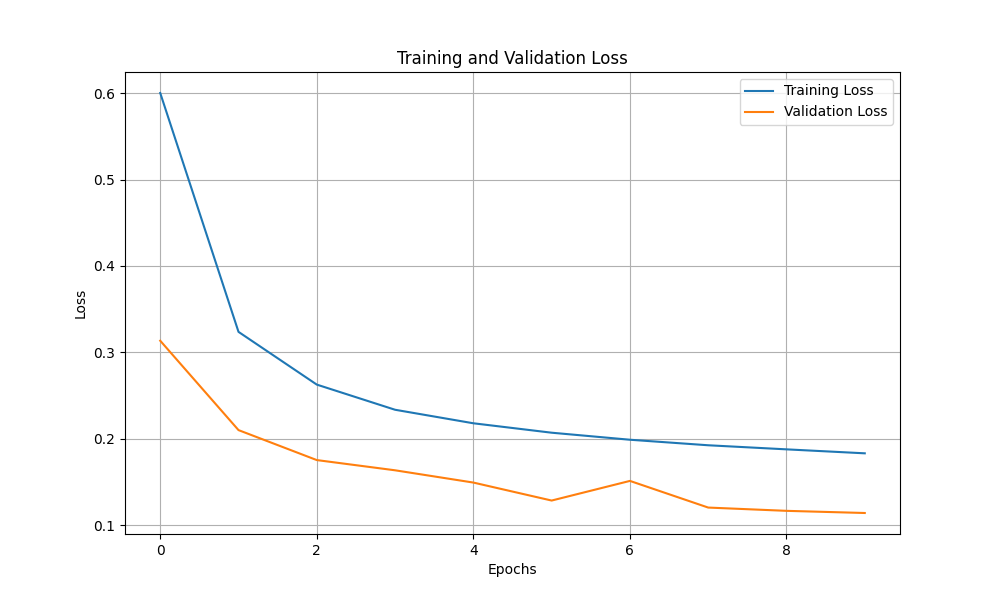

In [28]:
import matplotlib.pyplot as plt
import numpy as np

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(train_loss_list, label='Training Loss')
plt.plot(validation_loss_list, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()


In [29]:
import torch
# Fetch one batch from the test_dataloader
for batch in test_dataloader:
    print(f"Batch structure: {type(batch)}")
    if isinstance(batch, (list, tuple)):
        print(f"Number of elements in the batch: {len(batch)}")
    # Optionally, print the shapes or types of the first few elements to understand their structure
    for i, item in enumerate(batch):
        if torch.is_tensor(item):
            print(f"Element {i} shape: {item.shape}")
        else:
            print(f"Element {i} is a {type(item)}")
    break  # Only inspect the first batch


Batch structure: <class 'numpy.ndarray'>
Element 0 is a <class 'numpy.ndarray'>
Element 1 is a <class 'numpy.ndarray'>
Element 2 is a <class 'numpy.ndarray'>
Element 3 is a <class 'numpy.ndarray'>
Element 4 is a <class 'numpy.ndarray'>
Element 5 is a <class 'numpy.ndarray'>
Element 6 is a <class 'numpy.ndarray'>
Element 7 is a <class 'numpy.ndarray'>
Element 8 is a <class 'numpy.ndarray'>
Element 9 is a <class 'numpy.ndarray'>
Element 10 is a <class 'numpy.ndarray'>
Element 11 is a <class 'numpy.ndarray'>
Element 12 is a <class 'numpy.ndarray'>
Element 13 is a <class 'numpy.ndarray'>
Element 14 is a <class 'numpy.ndarray'>
Element 15 is a <class 'numpy.ndarray'>


In [30]:
def unnormalize_data(normalized_data, original_min, original_max, feature_range=(0, 1)):
    """
    Unnormalize data back to its original scale.
    
    Parameters:
    - normalized_data: The data to be unnormalized.
    - original_min: The minimum value of the original data before normalization.
    - original_max: The maximum value of the original data before normalization.
    - feature_range: The range to which the data was normalized.
    
    Returns:
    - unnormalized_data: Data converted back to its original scale.
    """
    min_val, max_val = feature_range
    # Reverse the scaling
    scaled_data = (normalized_data - min_val) / (max_val - min_val)
    # Reverse the normalization
    unnormalized_data = scaled_data * (original_max - original_min) + original_min
    return unnormalized_data


In [31]:
device = "cuda" if torch.cuda.is_available() else "cpu"

In [32]:
batch[0]

array([[12,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1, 13],
       [12,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1, 13]])

In [33]:
batch[1]

array([[12, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 13],
       [12, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 13]])

In [34]:
batch[2]

array([[12,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1, 13],
       [12,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1, 13]])

In [35]:
batch[3]

array([[12, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 13],
       [12, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 13]])

In [36]:
# Test the predict function with your examples
examples = [
    torch.tensor([[12, 9,  9,  9,  9,  9,  9, 10, 10, 10, 10, 13]], dtype=torch.long, device=device),
    torch.tensor([[12,  8,  8,  8,  9,  9,  9,  9,  9,  9, 10,13]], dtype=torch.long, device=device),
    torch.tensor([[12, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 13]], dtype=torch.long, device=device),
    torch.tensor([[12, 10, 10, 10, 10, 13]], dtype=torch.long, device=device),
    torch.tensor([[12, 10, 10, 13]], dtype=torch.long, device=device),
]

for idx, example in enumerate(examples):
    result = tf.predict(model, example, max_length=15,SOS_token=12, EOS_token=13)
    print(f"Example {idx}")
    print(f"Input: {example[0, 1:-1].tolist()}")  # Exclude SOS and EOS tokens for the input display
    print(f"Continuation: {result[1:-1]}")  # Exclude the SOS and EOS token from the continuation display
    print()

Example 0
Input: [9, 9, 9, 9, 9, 9, 10, 10, 10, 10]
Continuation: [9, 9, 9, 9, 9, 10, 10, 10, 10, 10]

Example 1
Input: [8, 8, 8, 9, 9, 9, 9, 9, 9, 10]
Continuation: [8, 9, 9, 9, 9, 9, 9, 9, 9]

Example 2
Input: [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]
Continuation: [10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10]

Example 3
Input: [10, 10, 10, 10]
Continuation: [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]

Example 4
Input: [10, 10]
Continuation: [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]



In [37]:
import numpy as np


def bins_to_scaled_values(binned_sequence):
    # Define midpoints for each bin
    bin_edges = np.linspace(0, 100, num=11)
    bin_midpoints = (bin_edges[:-1] + bin_edges[1:]) / 2

    # Convert binned_sequence to a NumPy array if it's not already
    if not isinstance(binned_sequence, np.ndarray):
        binned_sequence = np.array(binned_sequence)

    # Adjust binned_sequence to 0-based indexing
    adjusted_indices = binned_sequence - 1

    # Map each bin index in the sequence to its midpoint value
    scaled_sequence = bin_midpoints[adjusted_indices]
    
    return scaled_sequence



def reverse_normalize(scaled_values, original_max,precision=3):
    return [round(value / 100 * original_max,precision) for value in scaled_values]

# Assuming original_max is known or calculated from your original dataset
original_max = max(x_positions_FOi)  # Replace x_positions_FOi with your actual dataset

for idx, example in enumerate(examples):
    # Predict the continuation using the model
    result = tf.predict(model, example, max_length=15, SOS_token=12, EOS_token=13)
    
    # Process the input: Exclude SOS and EOS tokens, convert bins to scaled values, and reverse normalize
    input_binned = example[0, 1:-1].tolist()  # Excluding SOS/EOS
    input_scaled = bins_to_scaled_values(input_binned)
    input_original_scale = reverse_normalize(input_scaled, original_max)
    
    # Process the prediction: Exclude SOS and EOS tokens, convert bins to scaled values, and reverse normalize
    predicted_binned = result[1:-1]  # Excluding SOS/EOS
    predicted_scaled = bins_to_scaled_values(predicted_binned)
    predicted_original_scale = reverse_normalize(predicted_scaled, original_max)
    
    # Print the results
    print(f"Example {idx}")
    print(f"Input (Original Scale): {input_original_scale}")
    print(f"Prediction (Original Scale): {predicted_original_scale}")
    print()


Example 0
Input (Original Scale): [2.549, 2.549, 2.549, 2.549, 2.549, 2.549, 2.849, 2.849, 2.849, 2.849]
Prediction (Original Scale): [2.549, 2.549, 2.549, 2.549, 2.549, 2.849, 2.849, 2.849, 2.849, 2.849]

Example 1
Input (Original Scale): [2.249, 2.249, 2.249, 2.549, 2.549, 2.549, 2.549, 2.549, 2.549, 2.849]
Prediction (Original Scale): [2.249, 2.549, 2.549, 2.549, 2.549, 2.549, 2.549, 2.549, 2.549]

Example 2
Input (Original Scale): [2.849, 2.849, 2.849, 2.849, 2.849, 2.849, 2.849, 2.849, 2.849, 2.849]
Prediction (Original Scale): [2.849, 2.849, 2.849, 2.849, 2.849, 2.849, 2.849, 2.849, 2.849, 2.849, 2.849]

Example 3
Input (Original Scale): [2.849, 2.849, 2.849, 2.849]
Prediction (Original Scale): [2.849, 2.849, 2.849, 2.849, 2.849, 2.849, 2.849, 2.849, 2.849, 2.849]

Example 4
Input (Original Scale): [2.849, 2.849]
Prediction (Original Scale): [2.849, 2.849, 2.849, 2.849, 2.849, 2.849, 2.849, 2.849, 2.849, 2.849]

